In [2]:
import numpy as np
import random
import math
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.decomposition import NMF
from timeit import default_timer as timer
from scipy.linalg import svd

# LLenado de datos

In [3]:
# Retorna un array bidimensional con la base de datos con nindep 
# parámetros aleatorios y hasta nfeat rellean con datos
# dependientes de los anteriores
def fill_data(ndata, nfeat, nindep, max_val, max_err, max_mult):
    data = np.zeros((ndata, nfeat))
    for j in range(nfeat):
        if j < (nindep):
            for i in range (ndata):
                random.seed()
                data[i][j] = random.uniform(0, max_val)
        else:
            random.seed()
            mult = random.uniform(1, max_mult)
            for i in range (ndata):
                random.seed()
                err = random.uniform(0, max_err)
                data[i][j] = data[i][j%nindep] * mult + err
    return data

In [4]:
def compute_error(database, recover):
    [ndata, nfeat] = database.shape
    error = 0
    for i in range(ndata):
        for j in range(nfeat):
            error = error + math.sqrt((database[i][j] - recover[i][j])**2)
    return error/(ndata*nfeat*max_val)

In [5]:
max_val = 10
max_err = 0.5
max_mult = 2
ndata = 5000
nfeat = 10
nindep = 5
database = fill_data(ndata, nfeat, nindep, max_val, max_err, max_mult)

## PCA

Busca dos matrices; U, W una es la inversa de la otra (U = W^T, en particular son ortonormales) y queremos conseguir que sum_i=1^n (||x_i - U*W*x_i||_2)^2 sea mínimo, ajustamos las matrices U, W adecuadas. Una de estas matrices es W \in R^(d,n) donde d < n => x \in R^n ---> W*x \in R^d. La matriz U es la inversa de W y recupera la dimensión original.

In [6]:
start = timer()
for i in range(nfeat):
    lapstart = timer()
    pca = PCA(n_components = i)
    reduced_data = pca.fit_transform(database)
    recover = pca.inverse_transform(reduced_data)
    error = compute_error(database, recover)
    lapend = timer()
    if (i == nindep):
        print("%2.2f" % (error*100) + " %" + "    <---------"+ "    Time --> %.2f" % (lapend - lapstart) + " s")
    else:
        print("%2.2f" % (error*100) + " %"+"              "+  "    Time --> %.2f" % (lapend - lapstart) + " s")
end = timer()
print("\nTiempo --> %.2f" % (end - start) + " s")

30.57 %                  Time --> 0.23 s
23.51 %                  Time --> 0.19 s
17.87 %                  Time --> 0.20 s
13.80 %                  Time --> 0.27 s
6.71 %                  Time --> 0.17 s
0.50 %    <---------    Time --> 0.20 s
0.40 %                  Time --> 0.25 s
0.31 %                  Time --> 0.18 s
0.19 %                  Time --> 0.19 s
0.08 %                  Time --> 0.24 s

Tiempo --> 2.11 s


In [9]:
pca = PCA(n_components = nindep)
reduced_data = pca.fit_transform(database)
cov = pca.get_covariance()
recover = pca.inverse_transform(reduced_data)
error = compute_error(database, recover)

print("\n\nERROR\n")
print(error)
print("\n\n\n SVD A COV")
U, s, VT = svd(cov)
print("\n\nCOV\n")
print(cov, cov.shape)
print("\n\nS\n")
print(s, s.shape)
print("\n\nU\n")
print(U, U.shape)
print("\n\nVT\n")
print(VT, VT.shape)


print("\n\n\n SVD A DATABASE")
U, s, VT = svd(database)
print("\n\nDATABASE\n")
print(database, database.shape)
print("\n\nS\n")
print(s, s.shape)
print("\n\nU\n")
print(U, U.shape)
print("\n\nVT\n")
print(VT, VT.shape)



ERROR

0.005030495733741626



 SVD A COV


COV

[[ 8.25478906e+00 -1.49355115e-01  1.01605000e-01 -6.21992104e-02
   9.06110796e-02  9.70994077e+00 -1.88189409e-01  2.08423203e-01
  -8.64736965e-02  1.20216753e-01]
 [-1.49355115e-01  8.47157831e+00 -5.28282954e-03  5.20654665e-02
  -1.20145202e-01 -1.83219762e-01  1.08130323e+01 -1.03597312e-02
   7.57098342e-02 -1.60836786e-01]
 [ 1.01605000e-01 -5.28282954e-03  8.41332719e+00 -2.55149921e-01
  -1.08529865e-02  1.14387936e-01 -1.08713422e-03  1.65344921e+01
  -3.85310721e-01 -2.32409691e-03]
 [-6.21992104e-02  5.20654665e-02 -2.55149921e-01  8.29306177e+00
   2.85180137e-01 -6.67348752e-02  6.02299489e-02 -4.98038649e-01
   1.23727993e+01  3.74495507e-01]
 [ 9.06110796e-02 -1.20145202e-01 -1.08529865e-02  2.85180137e-01
   8.38016178e+00  1.08244839e-01 -1.49532252e-01 -1.79123842e-02
   4.16381614e-01  1.07835345e+01]
 [ 9.70994077e+00 -1.83219762e-01  1.14387936e-01 -6.67348752e-02
   1.08244839e-01  1.14384293e+01 -2.30995746e-0

# NMF

X = W*H, buscamos esas matrices W y H tal que ||X-W*H||_Frobeniusnorm sea mínimo, W \in R^n,d y H \in R^d,n. Para ello va iterando, reduce la dimensionalidad n_components.

In [108]:
# Le cuesta mucho calcular los últimos términos, lo ejecuto limitado a 200 iteraciones
start = timer()
for i in range(1, nfeat):
    lapstart = timer()
    model = NMF(n_components=i, init='random', random_state=0)
    reduced_data = model.fit_transform(database)
    recover = model.inverse_transform(reduced_data)
    error = compute_error(database, recover)
    lapend = timer()
    if (i == nindep):
        print("%2.2f" % (error*100) + " %" + "    <---------"+ "  Time --> %.2f" % (lapend - lapstart) + " s")
    else:
        print("%2.2f" % (error*100) + " %"+"              "+ "  Time --> %.2f" % (lapend - lapstart) + " s")
    
end = timer()
print("\nTiempoTotal --> %.2f" % (end - start) + " s")

28.17 %                Time --> 0.25 s


/home/man3/.local/lib/python3.8/site-packages/sklearn/decomposition/_nmf.py:1076: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"


22.17 %                Time --> 0.35 s
16.27 %                Time --> 0.35 s


/home/man3/.local/lib/python3.8/site-packages/sklearn/decomposition/_nmf.py:1076: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"


8.84 %                Time --> 0.38 s


/home/man3/.local/lib/python3.8/site-packages/sklearn/decomposition/_nmf.py:1076: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"


0.75 %    <---------  Time --> 0.43 s


/home/man3/.local/lib/python3.8/site-packages/sklearn/decomposition/_nmf.py:1076: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"


0.75 %                Time --> 0.49 s


/home/man3/.local/lib/python3.8/site-packages/sklearn/decomposition/_nmf.py:1076: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"


0.75 %                Time --> 0.50 s


/home/man3/.local/lib/python3.8/site-packages/sklearn/decomposition/_nmf.py:1076: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"


0.76 %                Time --> 0.53 s


/home/man3/.local/lib/python3.8/site-packages/sklearn/decomposition/_nmf.py:1076: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"


0.74 %                Time --> 0.68 s


/home/man3/.local/lib/python3.8/site-packages/sklearn/decomposition/_nmf.py:1076: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"


0.74 %                Time --> 0.65 s


/home/man3/.local/lib/python3.8/site-packages/sklearn/decomposition/_nmf.py:1076: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"


0.67 %                Time --> 0.76 s


/home/man3/.local/lib/python3.8/site-packages/sklearn/decomposition/_nmf.py:1076: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"


0.69 %                Time --> 0.85 s


/home/man3/.local/lib/python3.8/site-packages/sklearn/decomposition/_nmf.py:1076: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"


0.69 %                Time --> 0.87 s


/home/man3/.local/lib/python3.8/site-packages/sklearn/decomposition/_nmf.py:1076: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"


0.68 %                Time --> 0.92 s

TiempoTotal --> 8.02 s


In [109]:
# Le cuesta mucho calcular los últimos términos, le dejo ejecutar hasta el final
start = timer()
for i in range(1, nfeat):
    lapstart = timer()
    model = NMF(n_components=i, init='random', random_state=0, max_iter = 10000)
    reduced_data = model.fit_transform(database)
    recover = model.inverse_transform(reduced_data)
    error = compute_error(database, recover)
    lapend = timer()
    if (i == nindep):
        print("%2.2f" % (error*100) + " %" + "    <---------"+ "  Time --> %.2f" % (lapend - lapstart) + " s")
    else:
        print("%2.2f" % (error*100) + " %"+"              "+ "  Time --> %.2f" % (lapend - lapstart) + " s")
    
end = timer()
print("\nTiempoTotal --> %.2f" % (end - start) + " s")

28.17 %                Time --> 0.25 s
22.18 %                Time --> 0.69 s
16.27 %                Time --> 0.36 s
8.84 %                Time --> 0.39 s
0.75 %    <---------  Time --> 0.54 s
0.75 %                Time --> 0.73 s
0.68 %                Time --> 5.10 s
0.60 %                Time --> 10.25 s
0.50 %                Time --> 9.66 s
0.48 %                Time --> 8.86 s
0.34 %                Time --> 12.97 s
0.33 %                Time --> 10.59 s
0.30 %                Time --> 9.06 s
0.29 %                Time --> 10.86 s

TiempoTotal --> 80.32 s


In [110]:
model = NMF(n_components=nindep, init='random', random_state=0, max_iter=10000)
reduced_data = model.fit_transform(database)
recover = model.inverse_transform(reduced_data)
error = compute_error(database, recover)
print(error)

0.00748678938269072


# PLOT de los Datos


In [41]:
import matplotlib as mplt
mplt.rcParams.update({'figure.max_open_warning': 0})

In [92]:
def plot_bidim(database):
    ndata, nfeat = database.shape
    for i in range(nfeat):
        for j in range(i, nfeat):
            if (i != j):
                plt.figure(figsize=(5, 5))
                plt.plot(database[:, i],database[:, j],'o',markersize=2)
                plt.title("Comparamos col%d con col%d" % (i+1, j+1))


In [93]:
def plot_bidim_dep(database):
    ndata, nfeat = database.shape
    for i in range(nfeat):
        for j in range(i, nfeat):
            if (i != j and i == j%nindep):
                plt.figure(figsize=(5, 5))
                plt.plot(database[:, i],database[:, j],'o',markersize=2)
                plt.title("Comparamos col%d con col%d" % (i+1, j+1))


In [95]:
# Ambas bases de datos son del mismo tamaño
def plot_compare(database1, database2):
    ndata, nfeat = database1.shape
    for i in range(nfeat):
        plt.figure(figsize=(5, 5))
        plt.plot(database1[:, i],database2[:, i],'o',markersize=2)
        plt.title("Comparamos col%d de recover con col%d de original" % (i+1, i+1))
    

## 1º Prueba: PCA (==nindep)

In [119]:
pca = PCA(n_components = nindep)
reduced_data = pca.fit_transform(database)
recover = pca.inverse_transform(reduced_data)

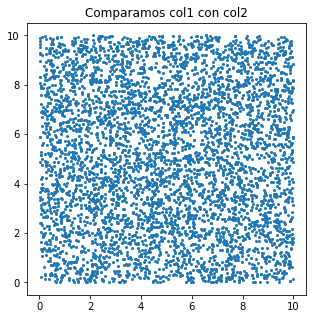

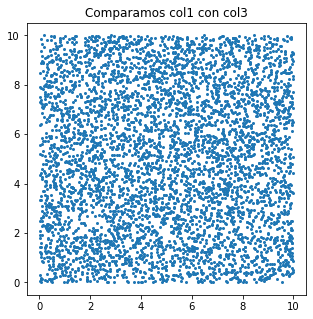

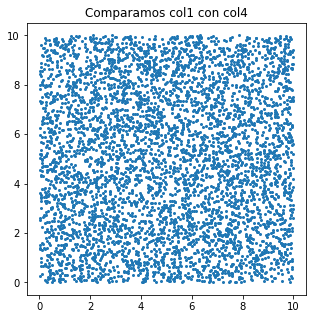

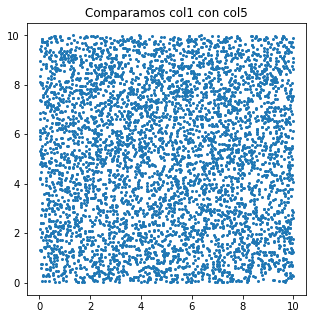

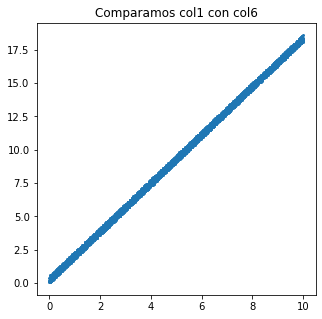

...

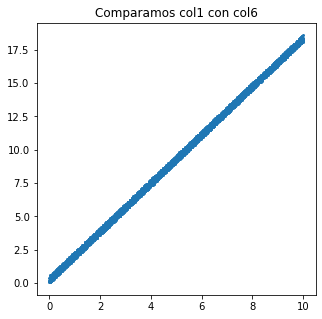

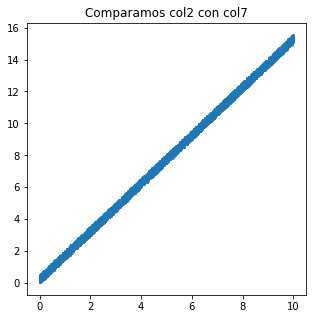

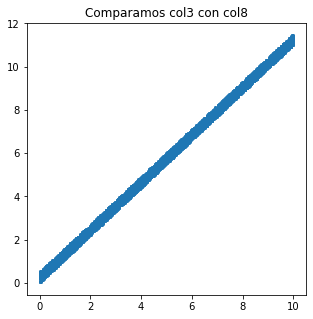

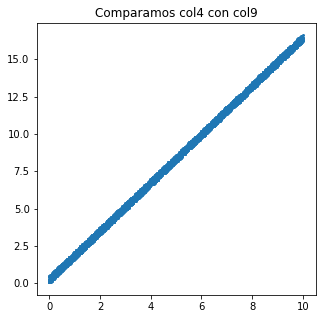

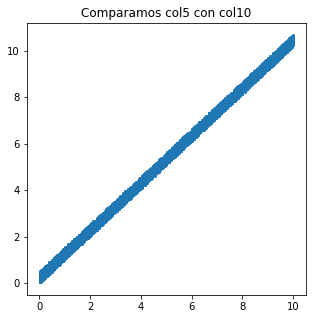

In [120]:
plot_bidim(database)
plot_bidim_dep(database)

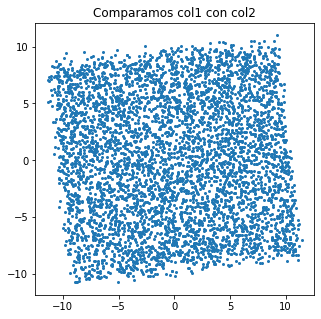

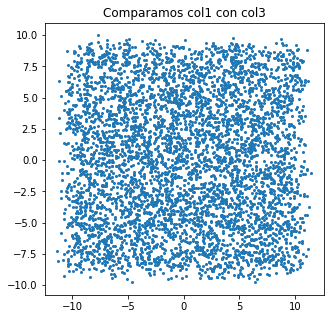

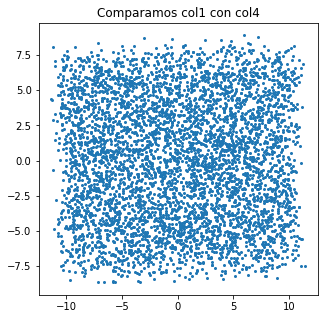

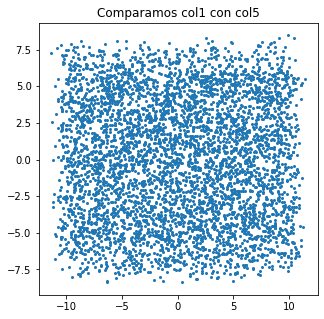

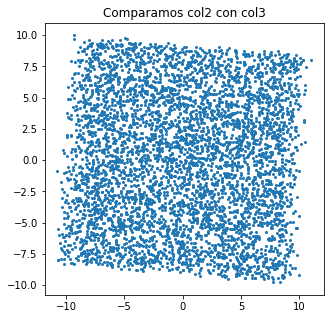

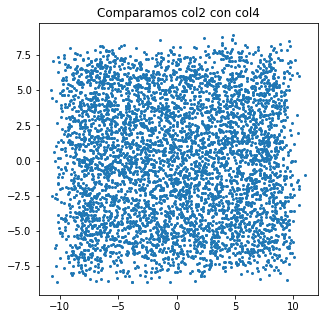

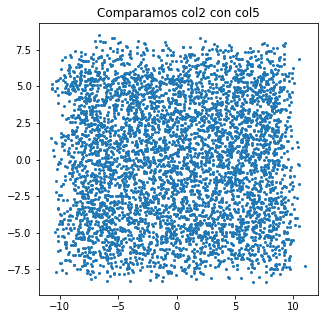

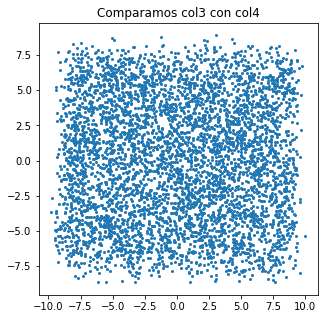

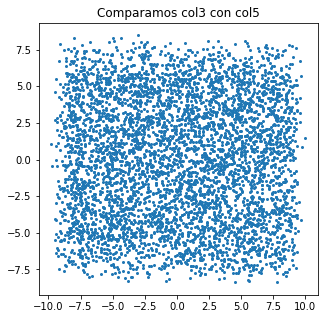

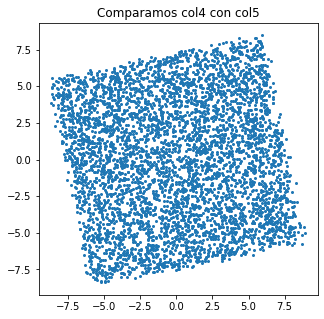

In [121]:
plot_bidim(reduced_data)
plot_bidim_dep(reduced_data)

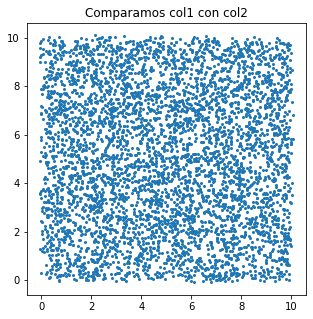

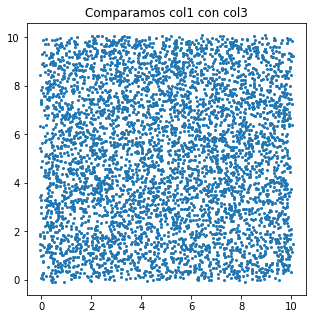

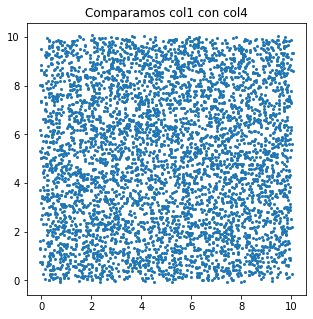

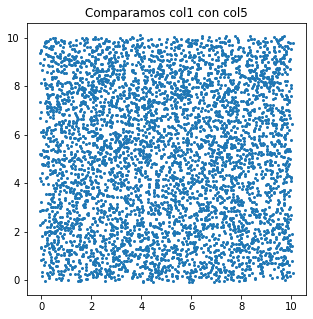

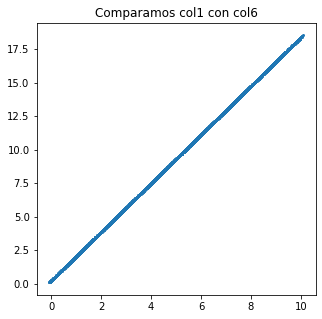

...

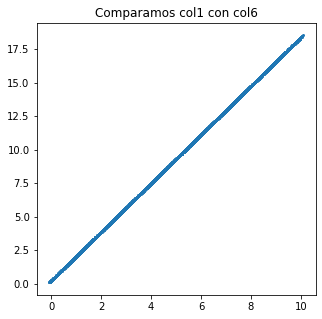

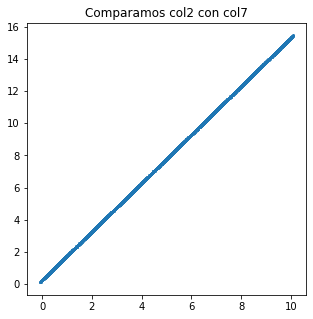

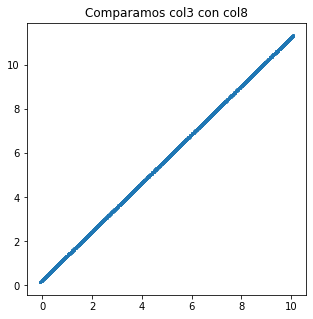

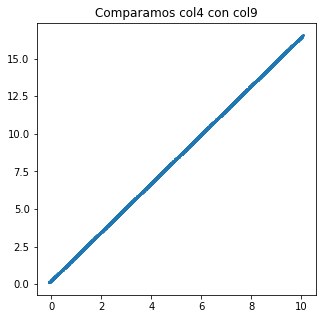

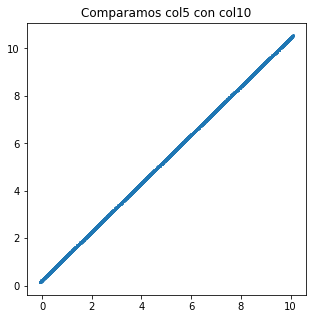

In [122]:
plot_bidim(recover)
plot_bidim_dep(recover)

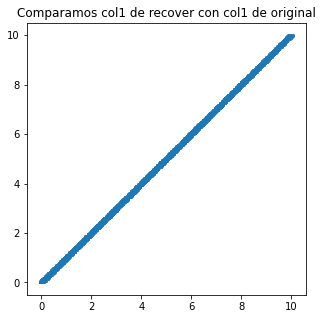

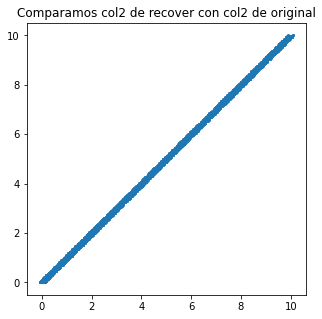

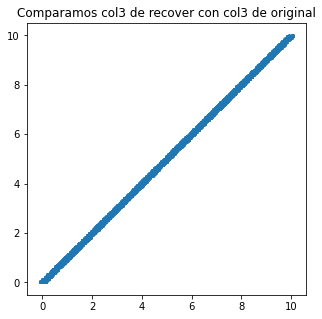

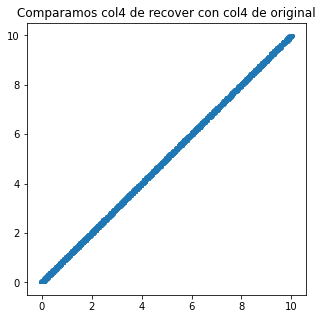

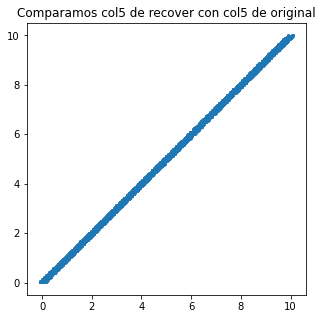

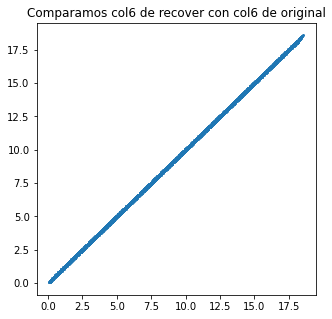

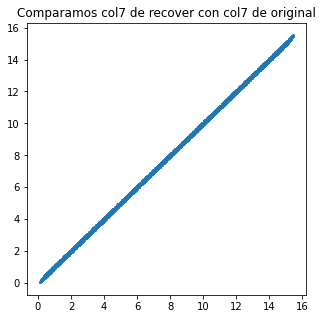

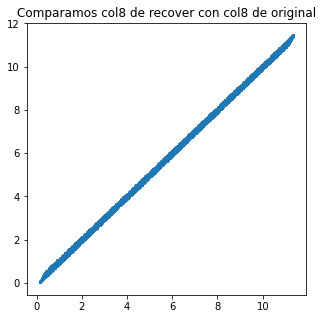

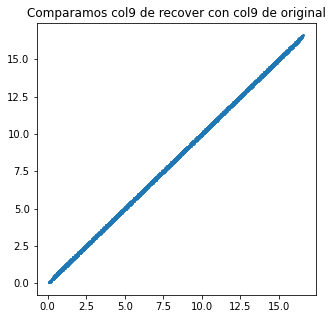

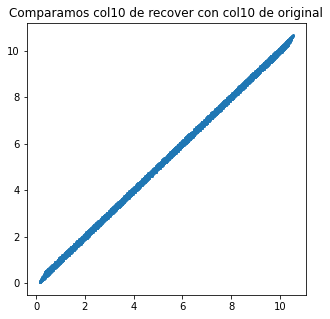

In [123]:
plot_compare(recover, database)

## 2º Prueba: PCA (<nindep) 

In [124]:
pca = PCA(n_components = nindep-int(nindep/2))
reduced_data = pca.fit_transform(database)
recover = pca.inverse_transform(reduced_data)

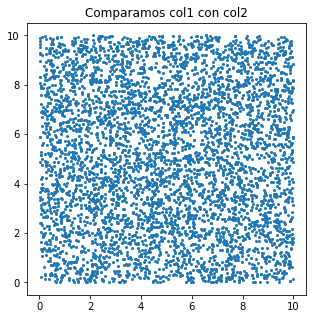

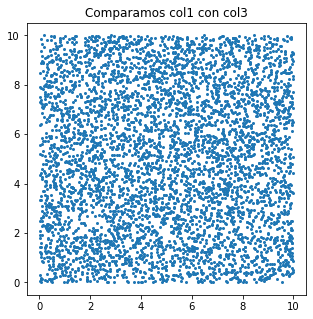

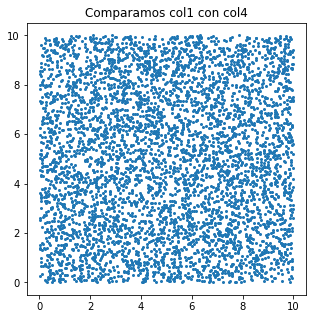

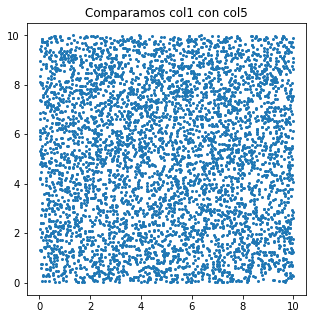

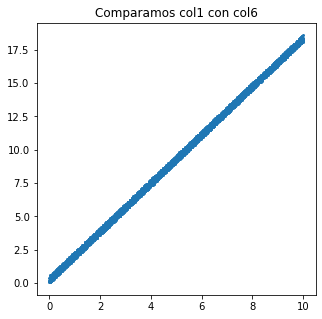

...

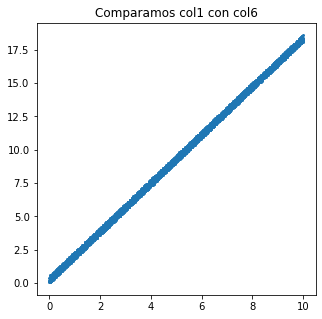

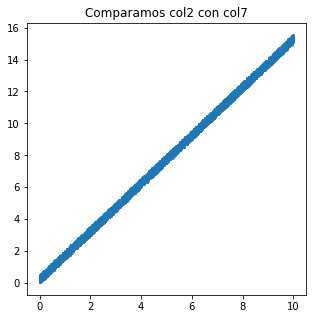

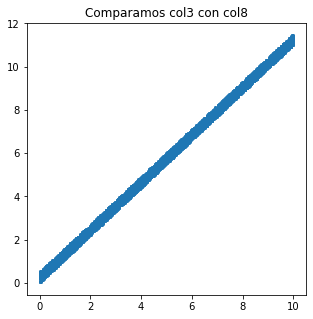

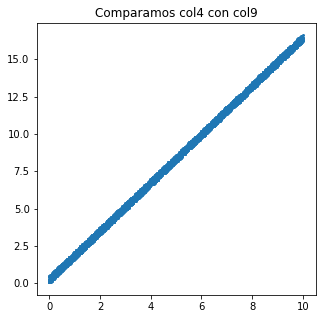

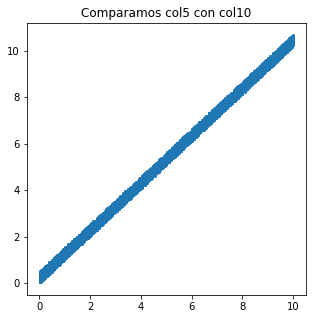

In [125]:
plot_bidim(database)
plot_bidim_dep(database)

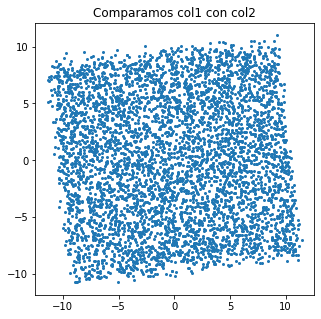

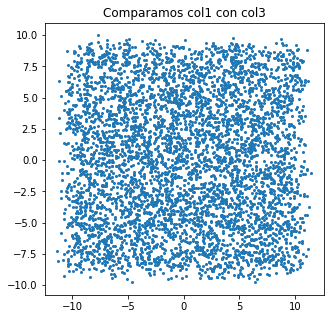

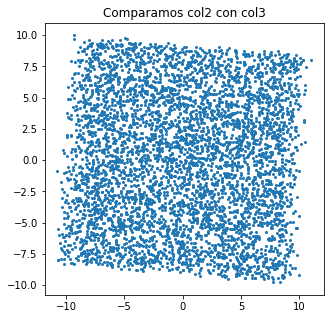

In [126]:
plot_bidim(reduced_data)
plot_bidim_dep(reduced_data)

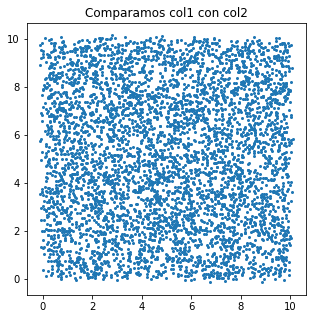

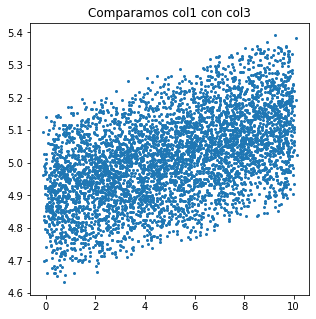

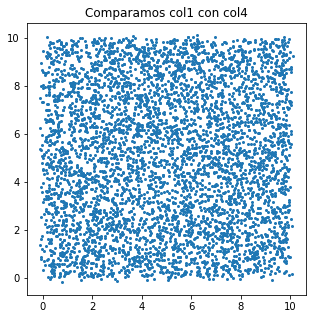

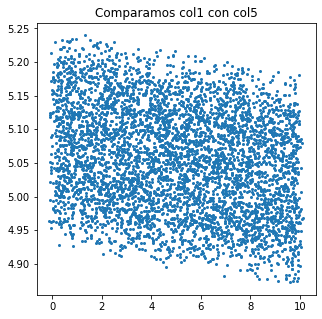

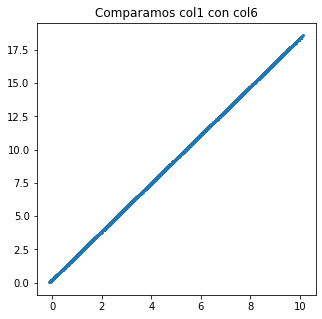

...

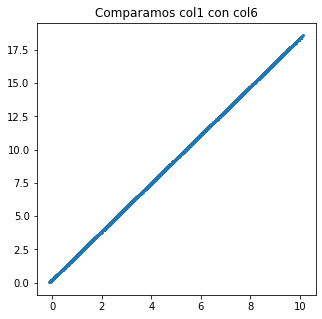

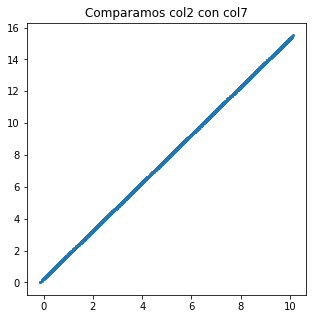

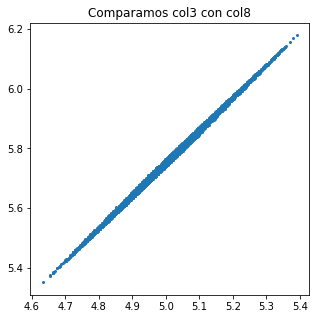

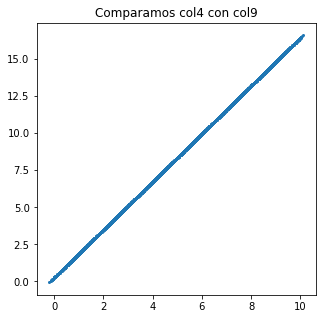

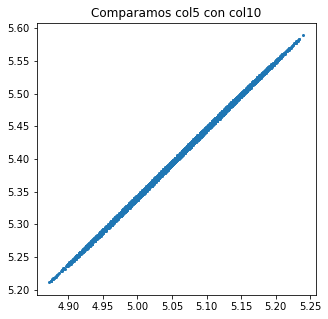

In [127]:
plot_bidim(recover)
plot_bidim_dep(recover)

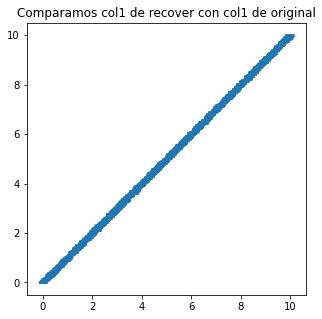

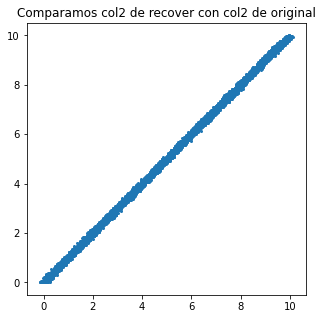

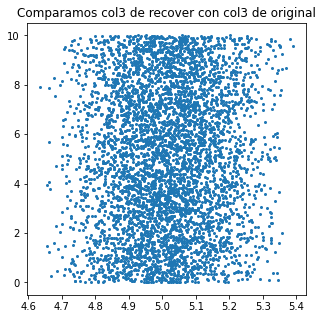

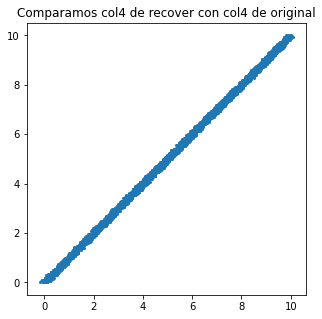

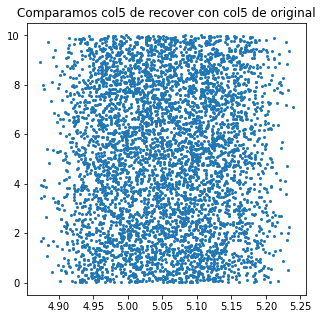

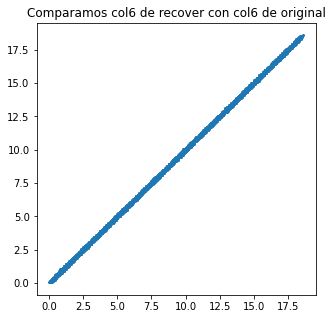

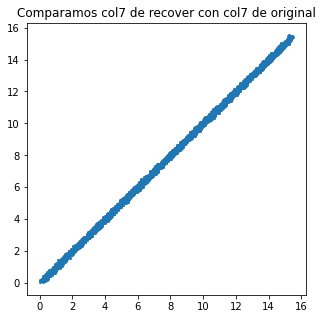

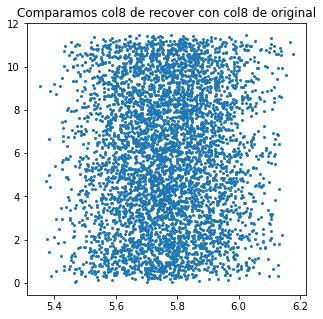

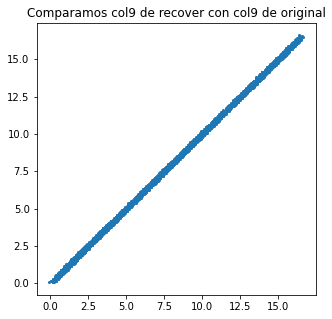

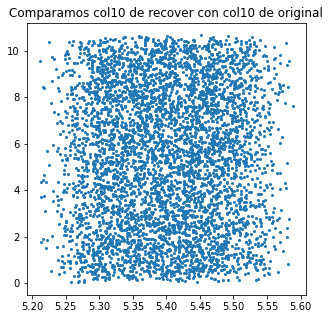

In [128]:
plot_compare(recover, database)

## 3º Prueba: PCA (>nindep) 

In [129]:
pca = PCA(n_components = nindep+int(nindep/2))
reduced_data = pca.fit_transform(database)
recover = pca.inverse_transform(reduced_data)

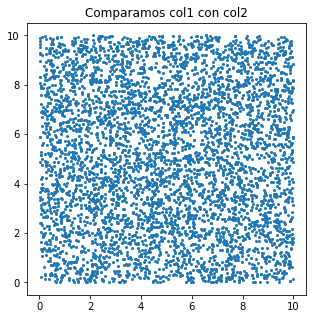

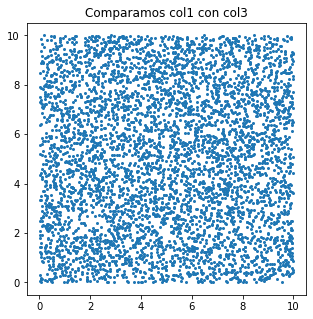

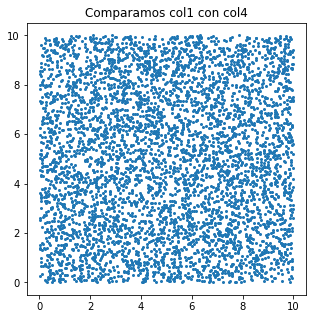

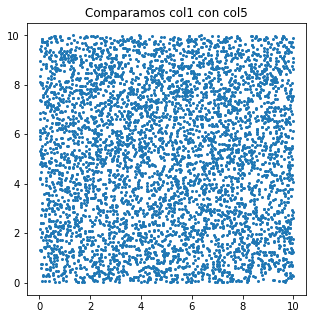

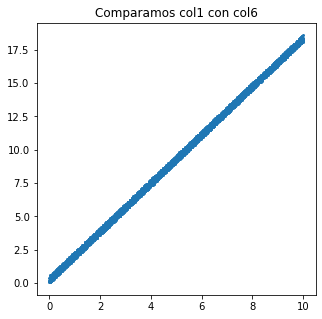

...

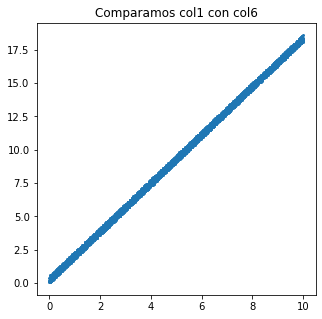

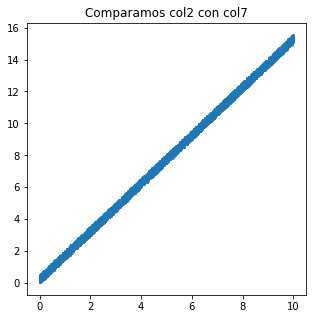

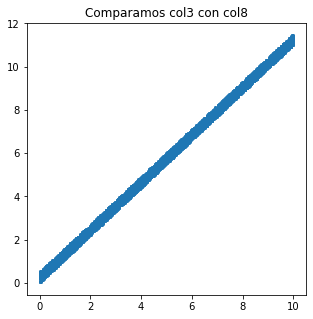

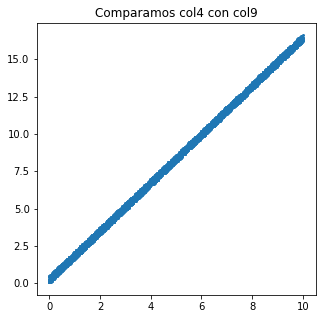

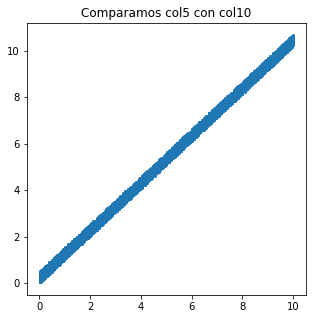

In [130]:
plot_bidim(database)
plot_bidim_dep(database)

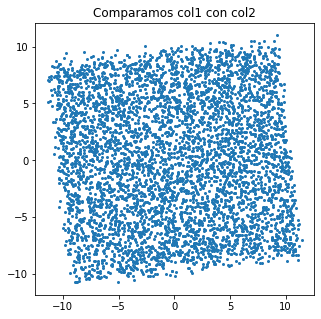

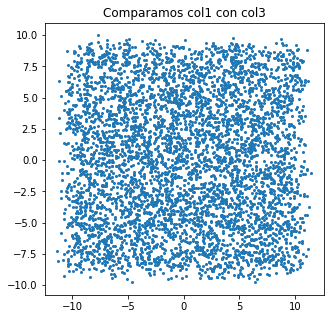

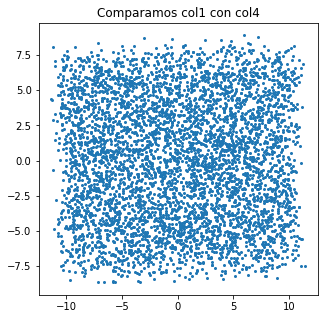

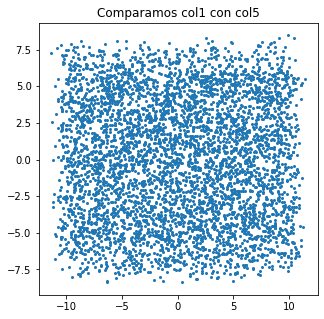

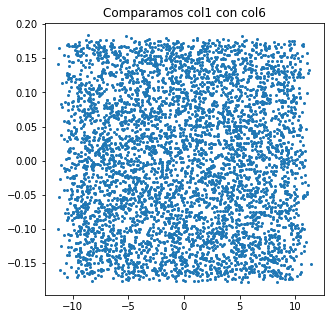

...

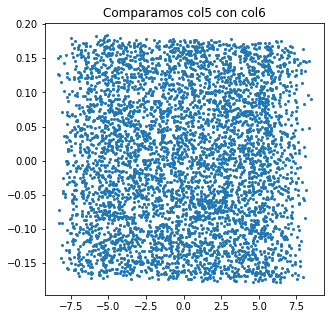

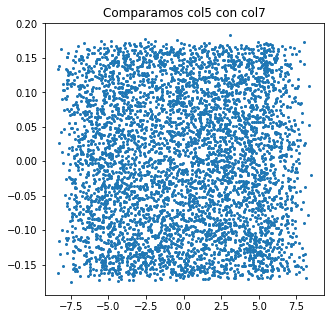

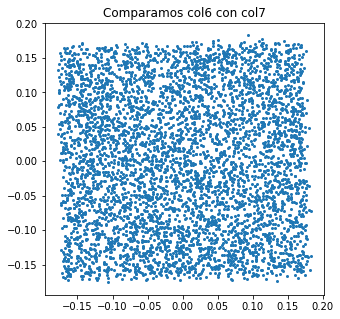

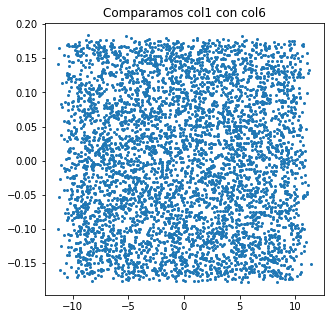

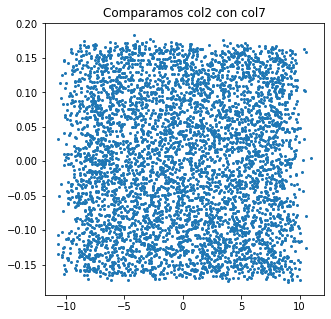

In [131]:
plot_bidim(reduced_data)
plot_bidim_dep(reduced_data)

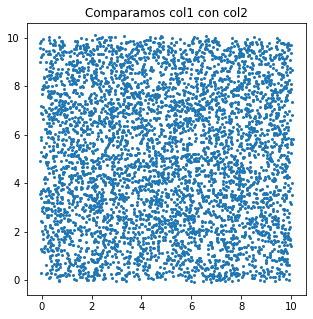

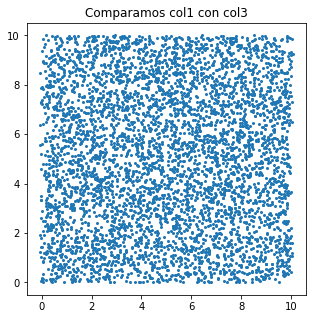

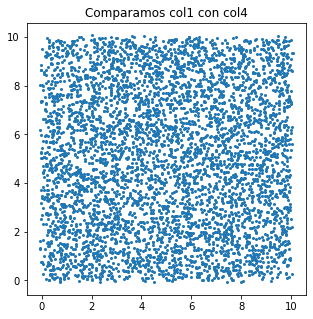

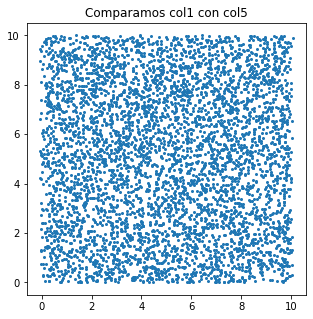

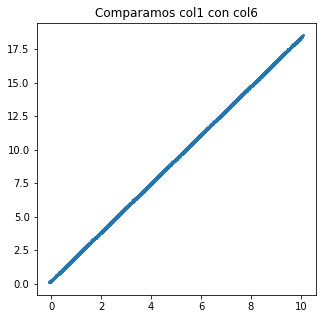

...

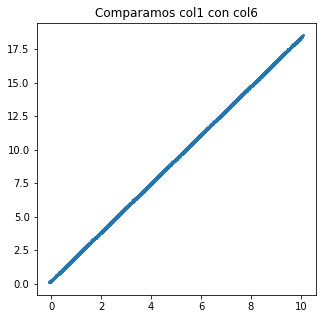

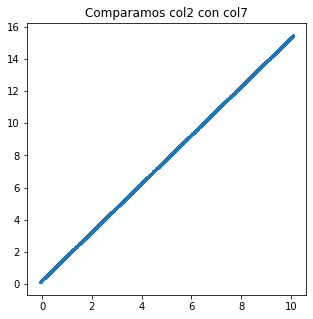

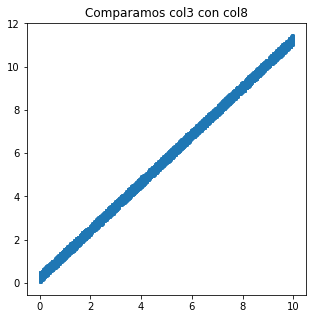

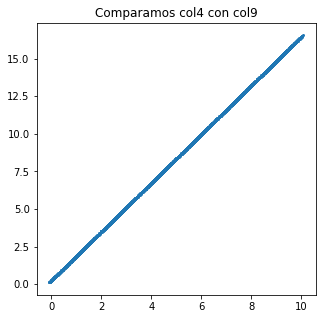

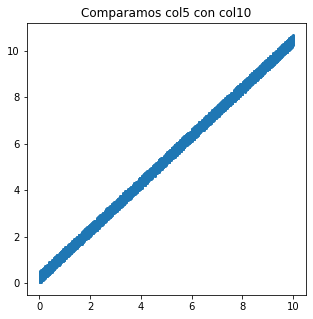

In [132]:
plot_bidim(recover)
plot_bidim_dep(recover)

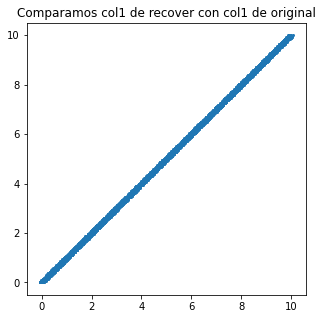

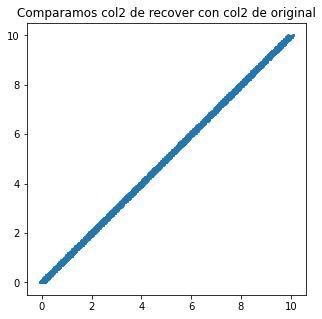

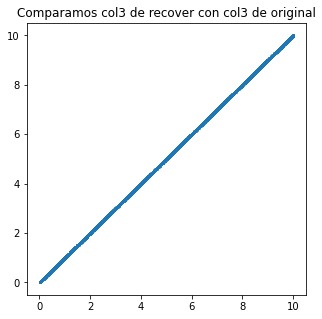

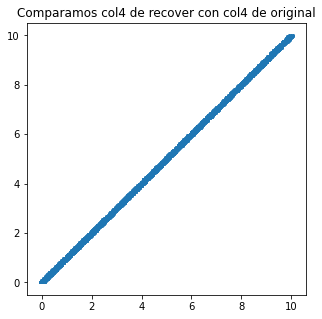

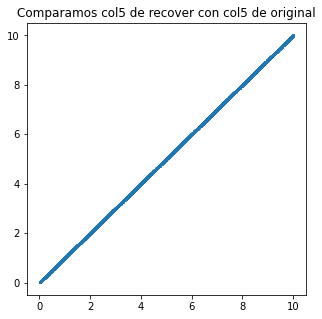

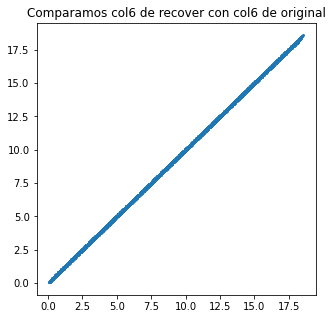

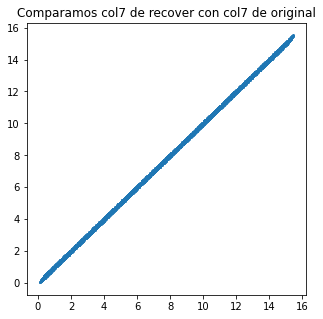

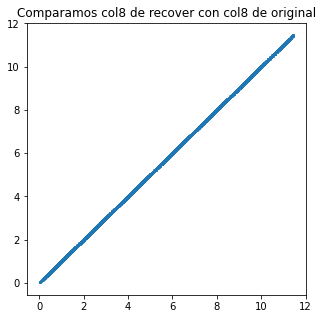

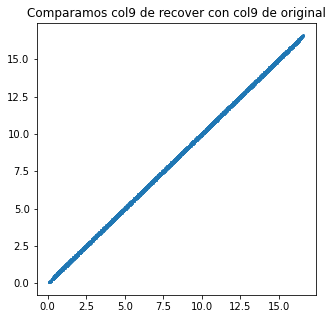

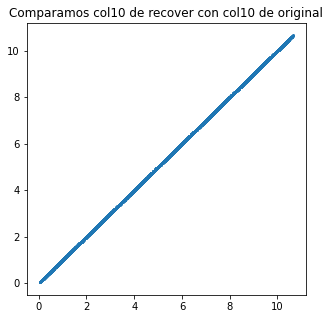

In [133]:
plot_compare(recover, database)

## 4º Prueba: NMF (==nindep)

In [134]:
model = NMF(n_components=nindep, init='random', random_state=0, max_iter=10000)
reduced_data = model.fit_transform(database)
recover = model.inverse_transform(reduced_data)

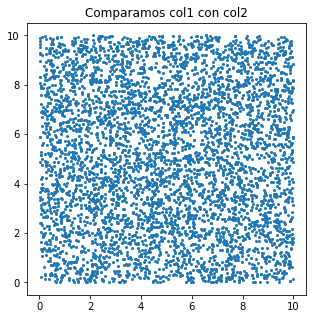

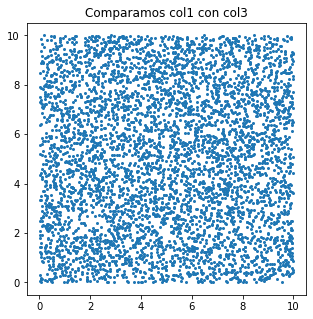

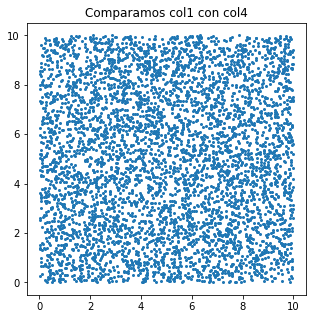

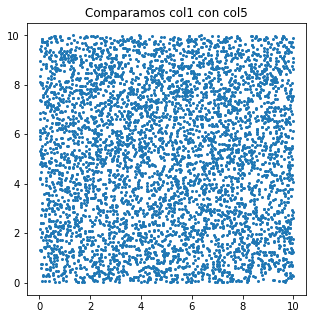

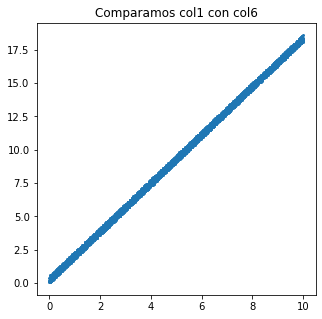

...

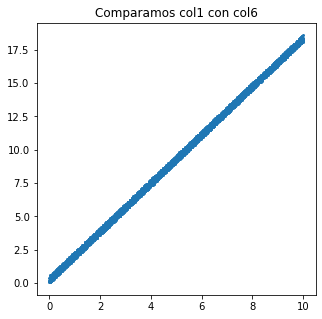

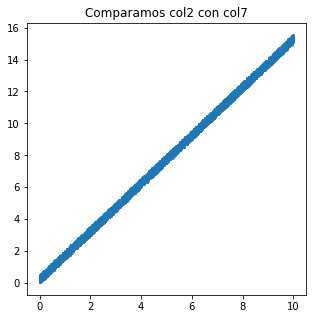

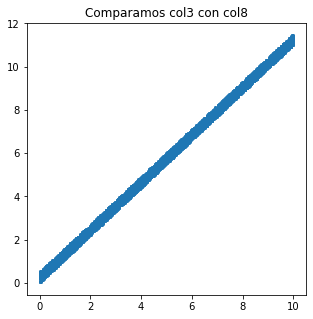

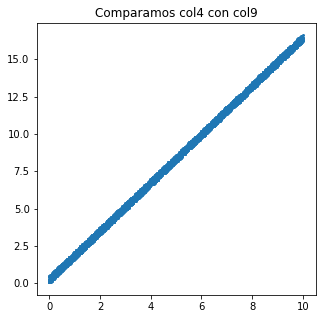

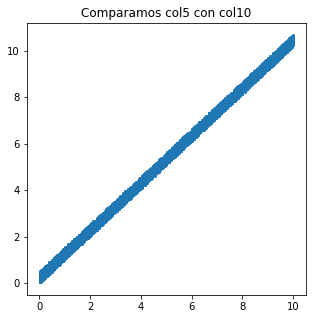

In [137]:
plot_bidim(database)
plot_bidim_dep(database)

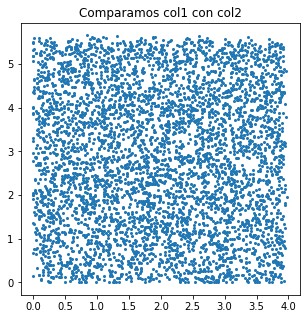

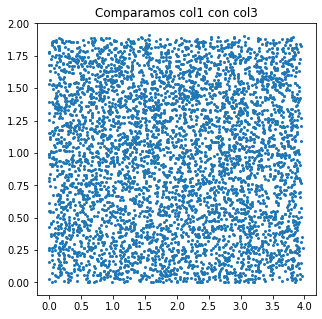

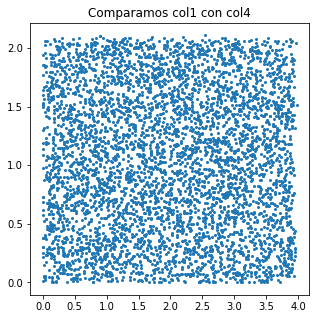

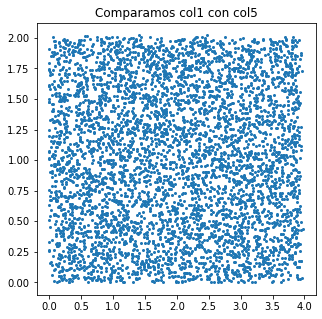

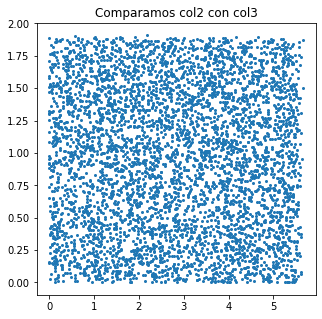

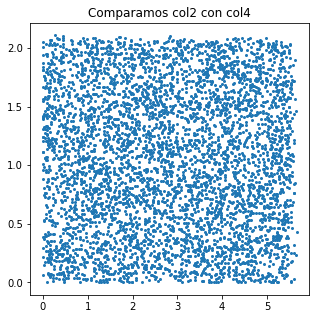

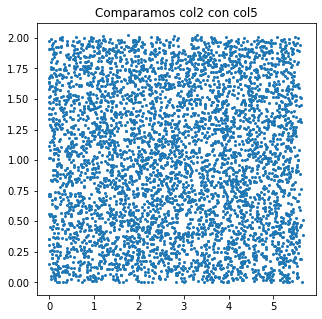

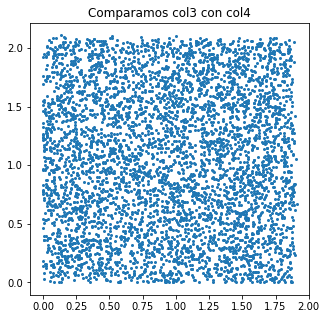

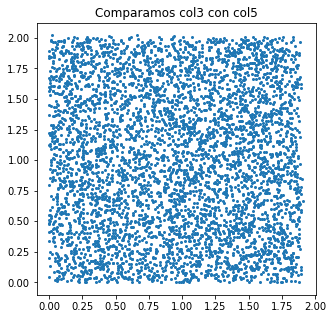

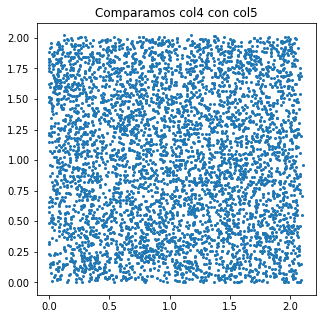

In [139]:
plot_bidim(reduced_data)
plot_bidim_dep(reduced_data)

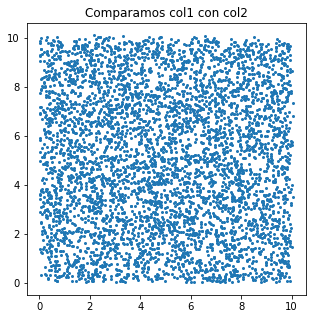

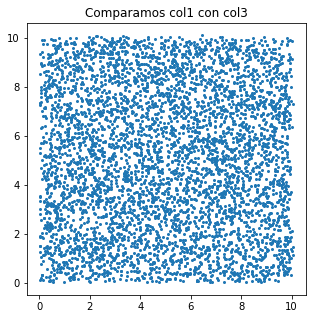

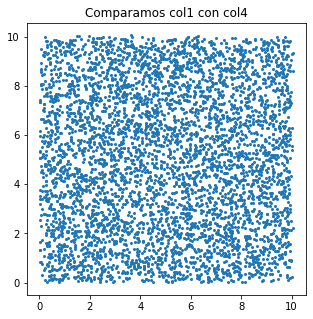

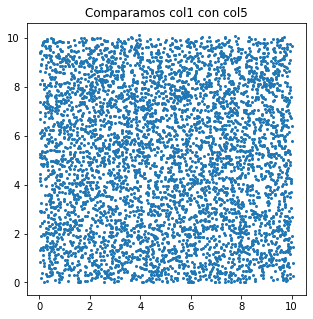

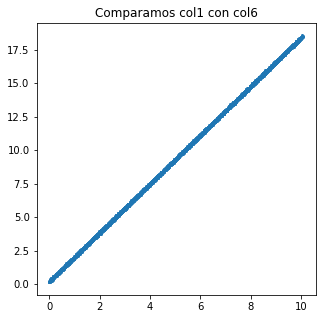

...

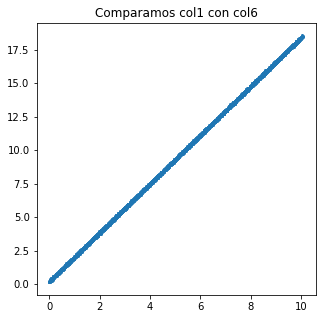

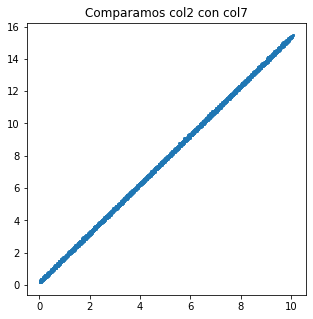

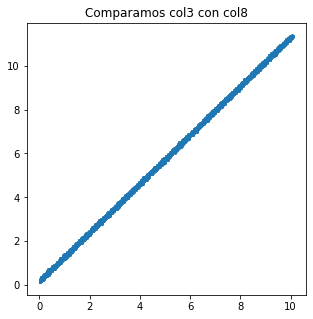

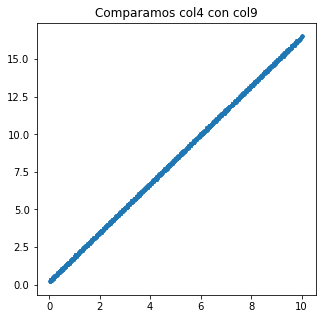

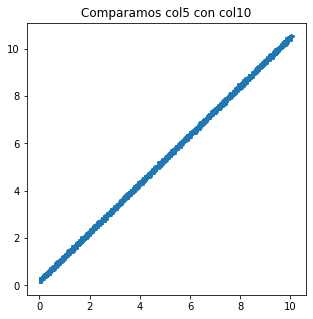

In [140]:
plot_bidim(recover)
plot_bidim_dep(recover)

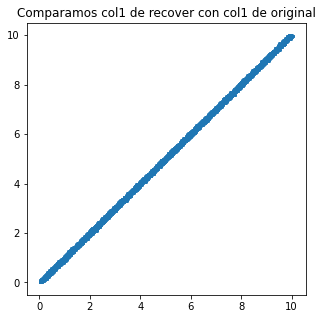

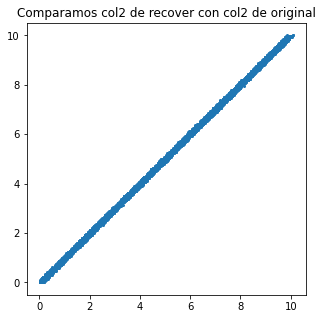

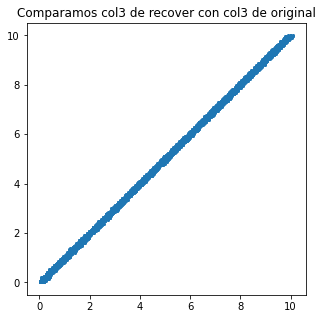

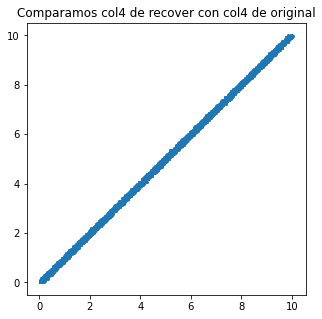

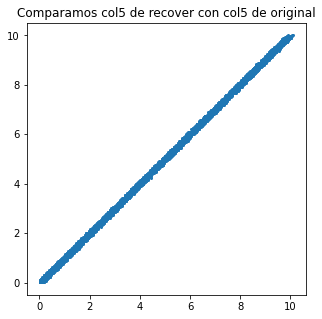

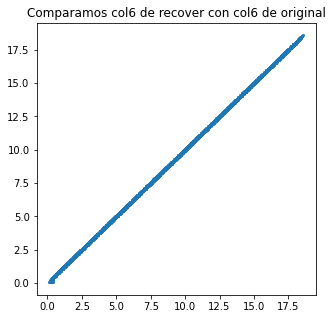

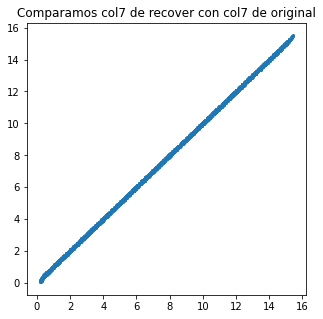

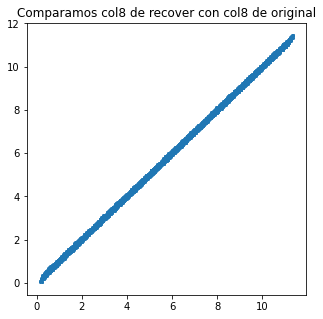

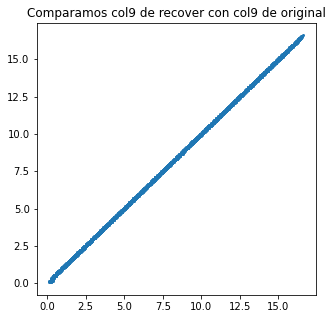

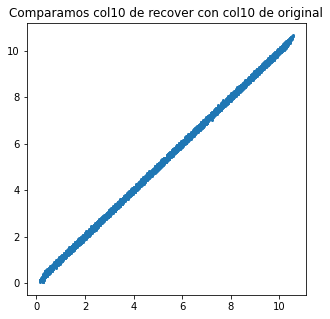

In [141]:
plot_compare(recover, database)

## 5º Prueba: NMF (<nindep) 

In [142]:
model = NMF(n_components=nindep-int(nindep/2), init='random', random_state=0, max_iter=10000)
reduced_data = model.fit_transform(database)
recover = model.inverse_transform(reduced_data)

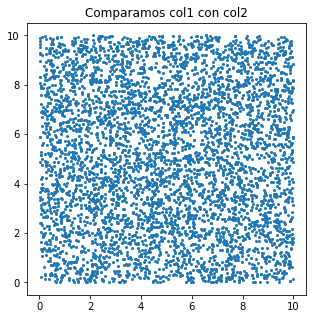

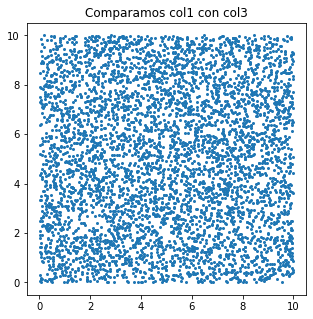

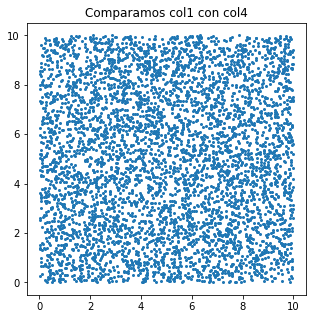

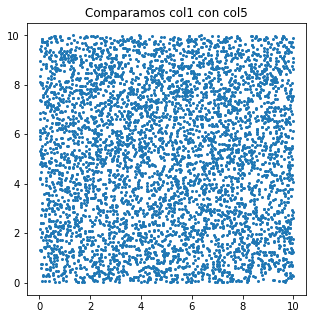

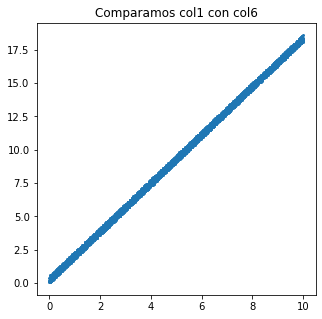

...

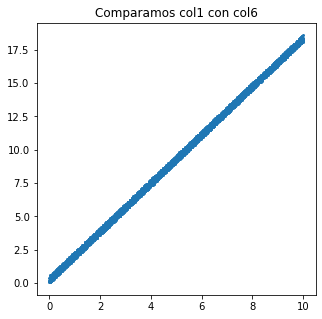

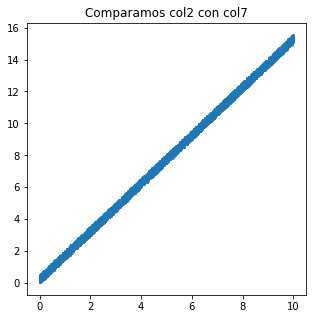

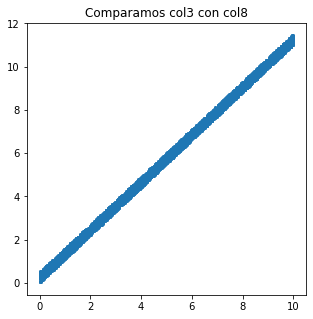

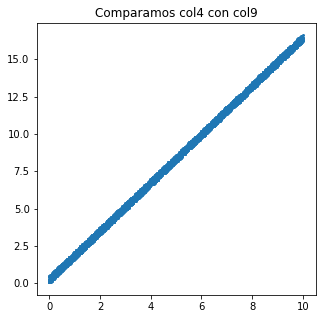

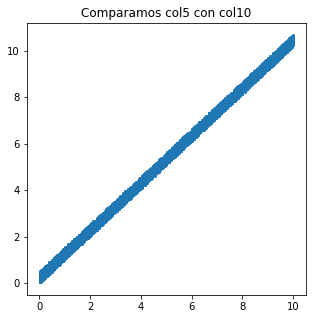

In [143]:
plot_bidim(database)
plot_bidim_dep(database)

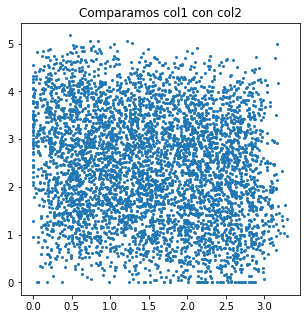

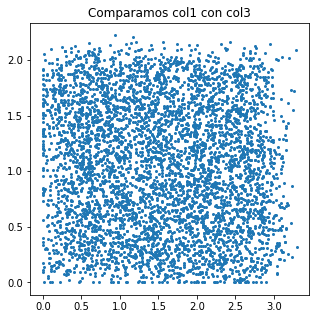

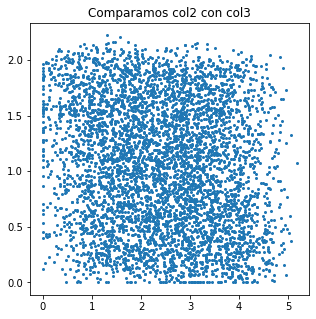

In [144]:
plot_bidim(reduced_data)
plot_bidim_dep(reduced_data)

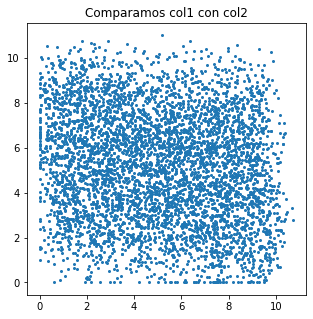

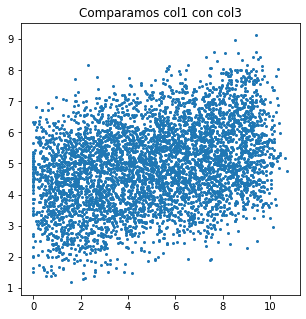

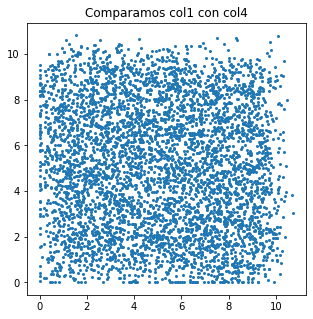

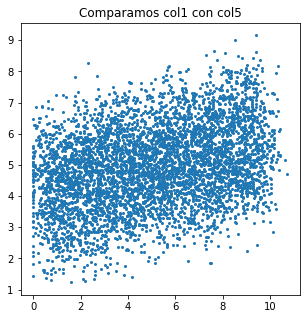

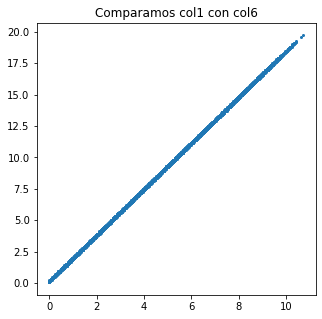

...

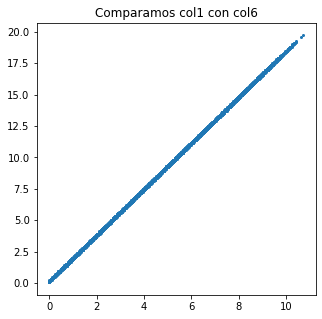

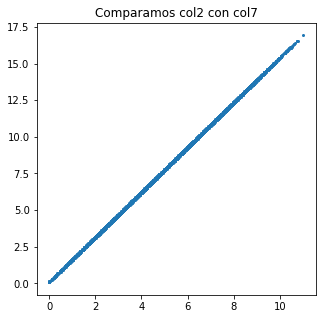

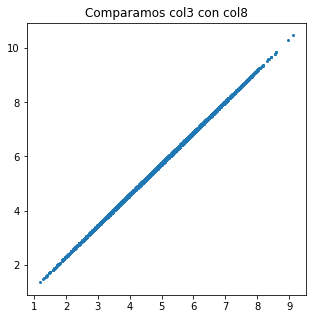

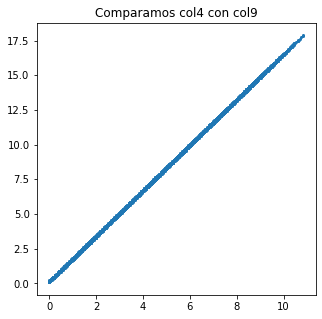

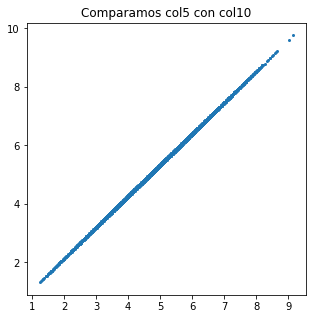

In [145]:
plot_bidim(recover)
plot_bidim_dep(recover)

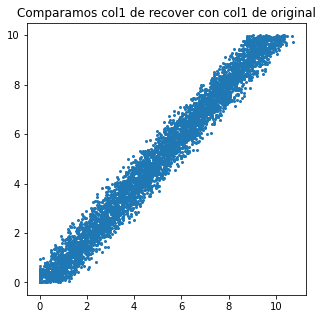

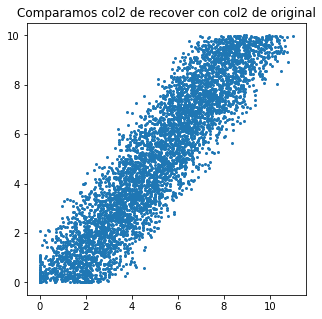

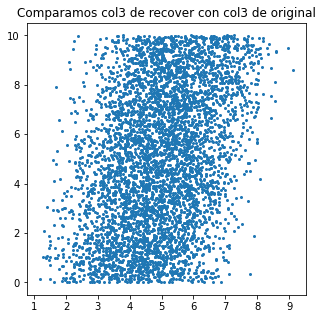

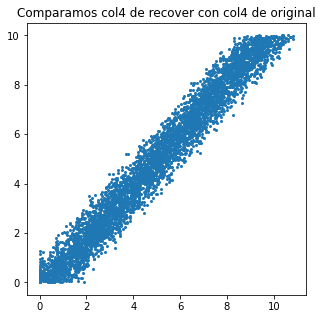

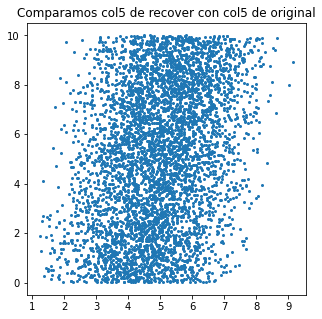

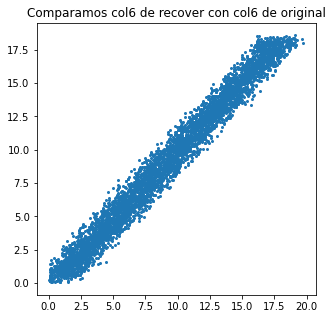

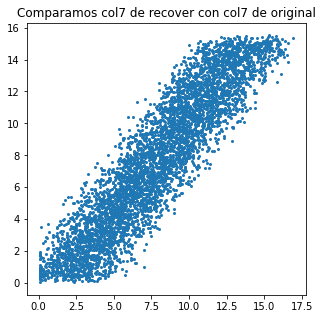

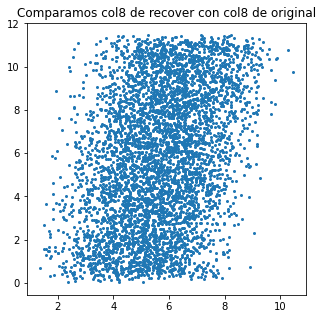

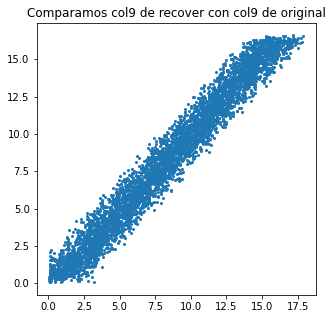

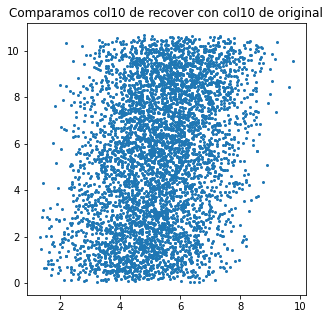

In [146]:
plot_compare(recover, database)

## 6º Prueba: NMF (>nindep) 

In [147]:
model = NMF(n_components=nindep+int(nindep/2), init='random', random_state=0, max_iter=10000)
reduced_data = model.fit_transform(database)
recover = model.inverse_transform(reduced_data)

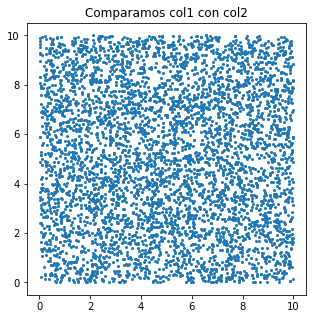

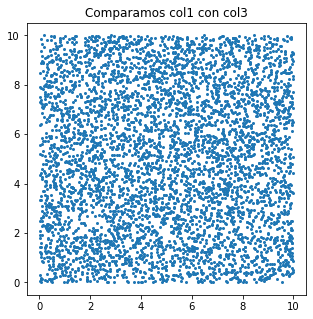

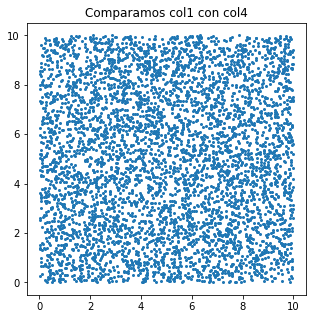

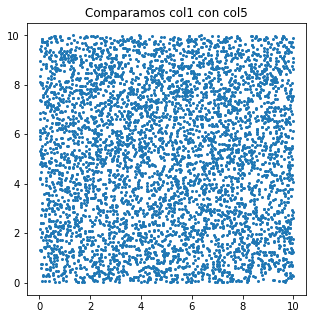

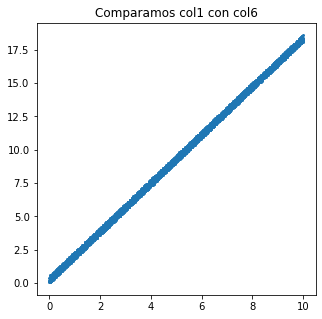

...

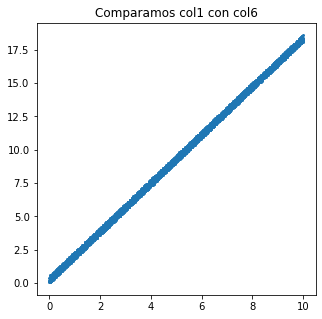

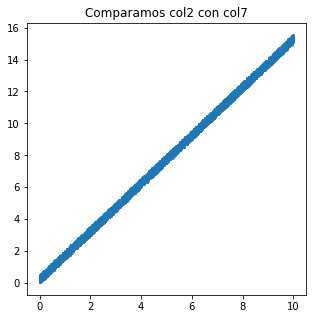

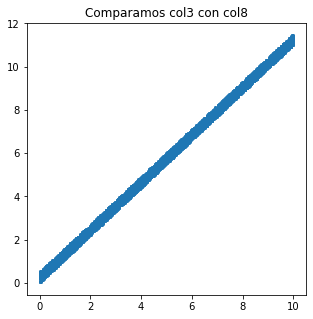

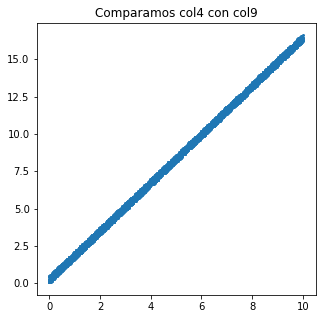

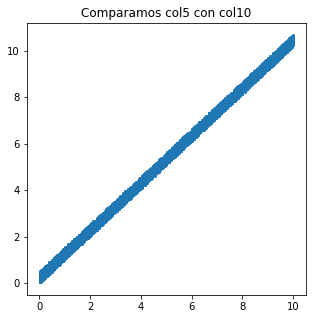

In [148]:
plot_bidim(database)
plot_bidim_dep(database)

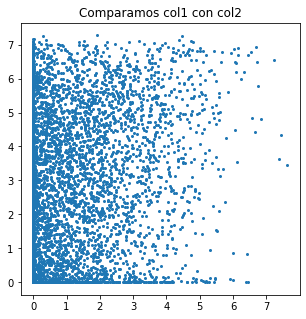

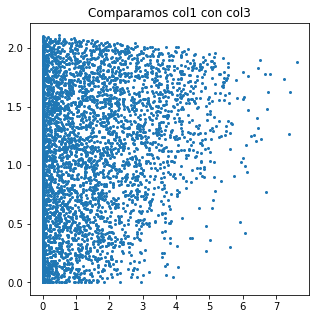

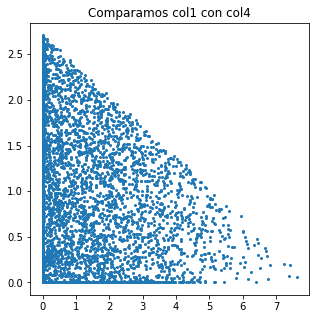

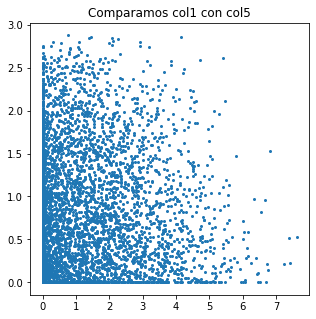

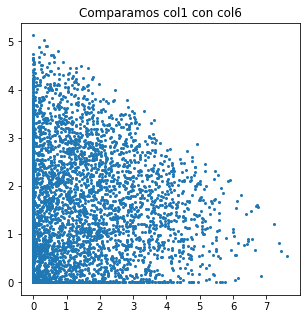

...

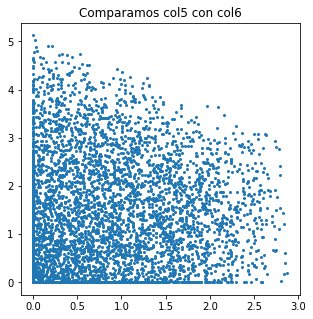

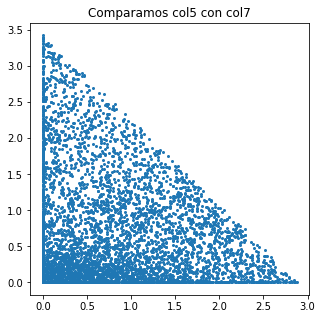

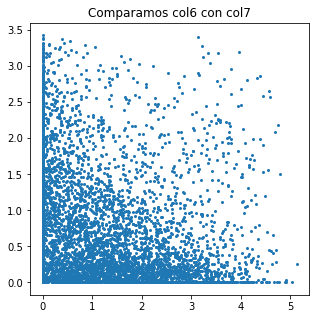

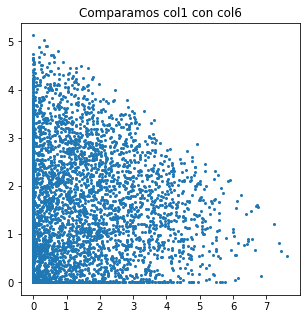

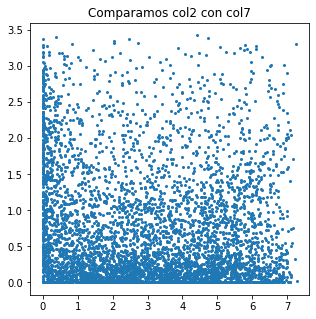

In [149]:
plot_bidim(reduced_data)
plot_bidim_dep(reduced_data)

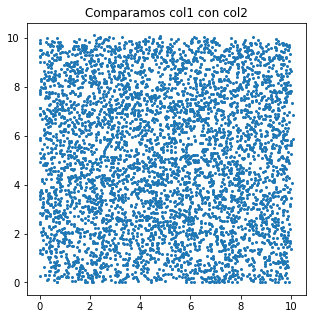

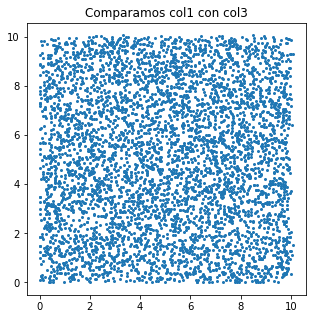

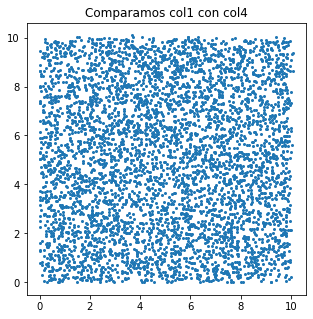

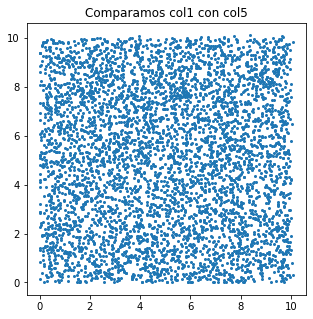

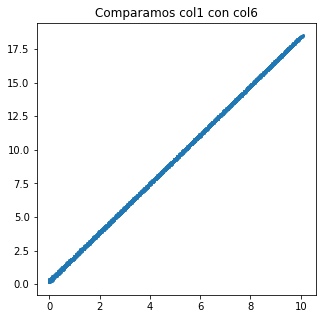

...

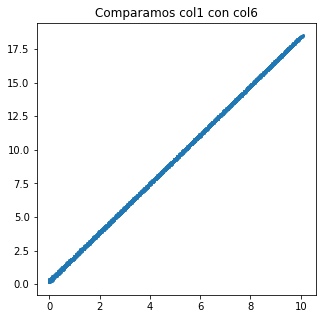

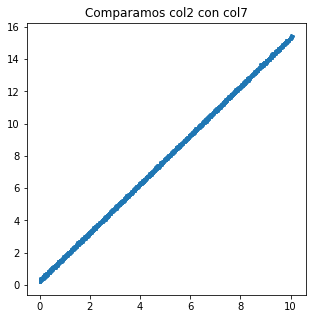

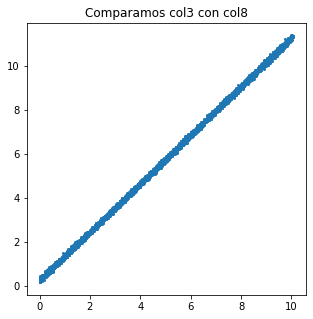

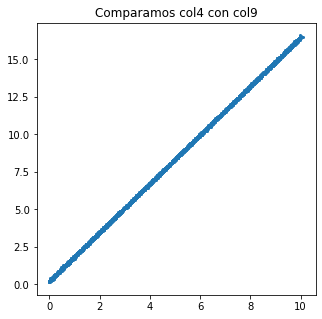

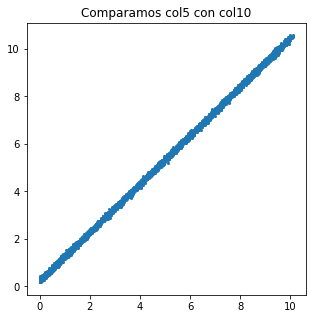

In [150]:
plot_bidim(recover)
plot_bidim_dep(recover)

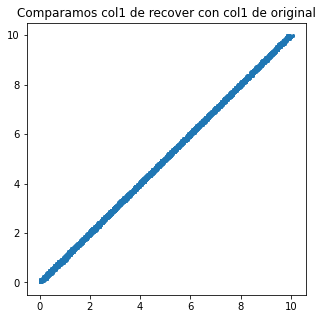

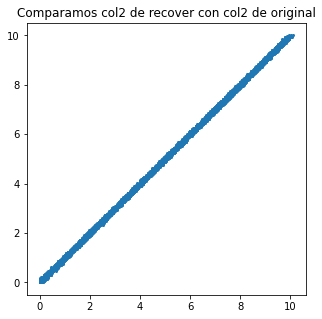

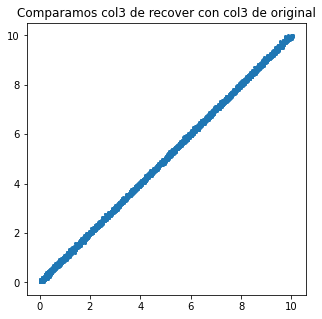

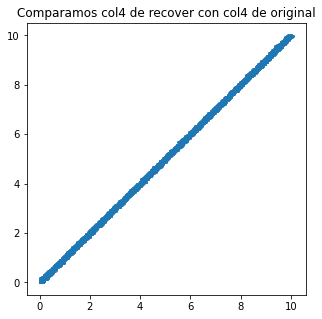

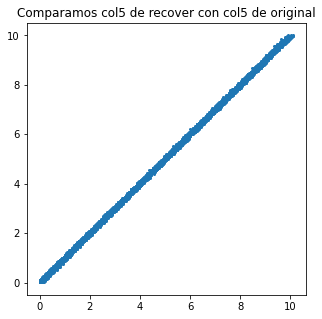

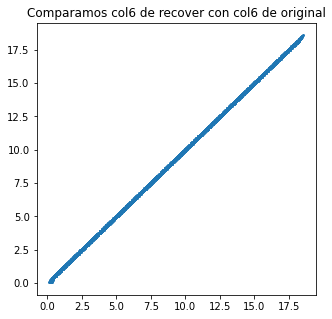

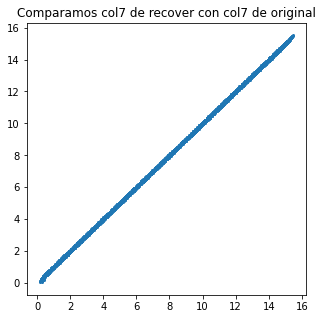

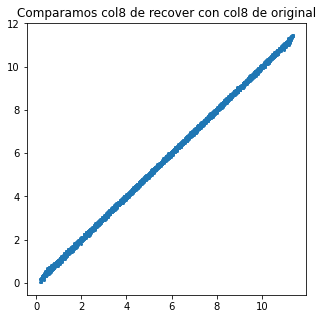

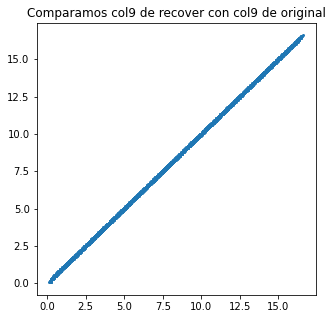

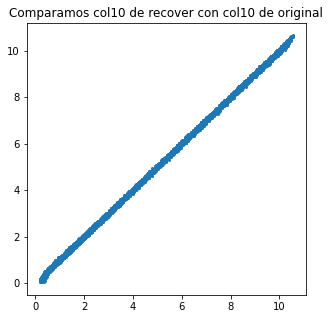

In [151]:
plot_compare(recover, database)

## OBSERVACIONES

- En los datos originales las columnas dependientes representan una diagonal con cierto "ruido" metido a propósito.
- En los datos originales las columnas independientes son una nube de puntos (lo esperado ya que son aleatorios).

####  -  Reduciendo database a los atributos realmente independientes(PCA).
- En los datos reducidos todas las comparaciones entre columnas son independientes (lo esperado ya que lo hemos construido así a proposito) y las nubes de puntos de los datos originales están "giradas".
- Cuando recuperamos los datos  volvemos a tener las nubes de puntos que teníamos en los datos originales para columnas independientes.
- Los datos dependientes en los datos recuperados se representan como una diagonal mucho mejor definida que en los datos originales, se ha perdido el ruido que hemos metido.
- La recuperación de datos ha sido bastante fiel a la realidad, representando la diagonal con algo de ruido. Lo ideal es que la recuperación de datos fuese una diagonal perfectamente trazada.

####  -  Reduciendo database a los atributos realmente independientes(NMF).
- Cuando ploteamos los datos reducidos vemos que en todos ellos se conserva la forma de nube de puntos. No hay columnas dependientes.
- Los datos recuperados son bastante fieles a los originales, observamos que al igual que pca afina las diagonales de las columnas dependientes reduciendo el ruido.

####  -  Reduciendo database a menos atributos  que los realmente independientes(PCA).
- De nuevo las gráficas de los datos reducidos están "girados"
- Cuando representamos los datos recuperados vemos como aparecen nubes de puntos giradas con tendencia tanto a una diagonal como a una diagonal invertida. Algunas gráficas se mantienen parecidas a las originales.
- Comparando columna por columna de cada base de datos, la recuperada y la original vemos como hay 4 columnas las cuales no tiene ni idea y el resto esboza una diagonal con algo de ruido. Lo cual es lo esperado porque hemos reducido a 3 independietes y cuando recuperamos hemos perdido 2 columnas.

####  - Reduciendo database a menos atributos  que los realmente independientes(NMF).
- Los datos reducidos representan la nube de puntos sin girar pero parece que faltan puntos en las escalas más pequeñas y grandes.
- Los datos recuperados una vez los representamos vemos algo parecido a lo que vimos en pca pero ninguna diagonal es invertida. Vemos también alguna nube de puntos "con algunos agujeros en escalas grandes y pequeñas".
- Comparando columna por columna de cada base de datos, la recuperada y la original vemos como las 4 columnas las cuales pca no tiene ni idea nmf parece que dibuja una nube con tendencia a la diagonal, pero muy poco. Las otras 6 columnas parece que si las recupera pero con mucho más ruido que pca. Por tanto deduzco que pca recupera muy bien las dimensiones que reduce y el resto las desconoce y nmf aunque no recupera tan bien las columnas reducidas mantiene una idea general de como era la base de datos original.

####  -  Reduciendo database a más atributos  que los realmente independientes(PCA).
- Los datos reducidos representan nubes de puntos, alguna giradas, al igual que hemos visto para los casos anteriores.
- Los datos recuperados son bastante fieles a los originales, más que en el primer caso ya que 2 diagonales de los datos dependientes han conservado el ruido que tenían. Lo esperado ya que le hemos dado 2 dimensiones de sobra.

####  - Reduciendo database a más atributos  que los realmente independientes(NMF).
- Los datos reducidos representan nubes con tendencia a la concentración en los valores bajos. Ambas columnas que se concentran muy por debajo de la media haciendo que en los gráficos los puntos se concentren en el origen (formando un triangulo) o en alguno de los dos ejes.
- Los datos recuperados son bastante fieles a los originales. Al contrario que pca, nmf recupera el ruido de todos los atributos dependientes, aunque derivado del análisis de error con 7 atributos tanto pca como nmf tienen un valor muy parecido lo cual me hace deducir que nmf recupera el ruido de todas las columnas pero aún así no es capaz de retener tanta información como pca por columna.

